In [15]:
import os
import cv2
import json
import random
import matplotlib.pyplot as plt

In [16]:
def read_image_and_json_from_folder(folder_path):
    image_files = [f for f in sorted(os.listdir(folder_path)) if f.endswith(('.png', '.jpg', '.jpeg'))]
    json_files = [f for f in sorted(os.listdir(folder_path)) if f.endswith('.json')]
    
    if image_files and json_files:
        # Choose a random image file
        image_filename = random.choice(image_files)
        base_filename = os.path.splitext(image_filename)[0]  # Extract base filename without extension
        
        # Find the corresponding JSON file
        json_filename = f'{base_filename}.json'
        if json_filename in json_files:
            img_path = os.path.join(folder_path, image_filename)
            json_path = os.path.join(folder_path, json_filename)
            
            # Read image
            img = cv2.imread(img_path)
            if img is None:
                return None, None, None
            
            # Read JSON
            try:
                with open(json_path, 'r', encoding='utf-8') as f:
                    if os.path.getsize(json_path) > 0:
                        json_data = json.load(f)
                        return image_filename, img, json_data
                    else:
                        print(f"Skipping empty JSON file: {json_path}")
            except (json.JSONDecodeError, UnicodeDecodeError) as e:
                print(f"Error reading {json_path}: {e}")
    return None, None, None

In [17]:
def draw_bounding_boxes(img, regions):
    for region in regions:
        shape_attrs = region['shape_attributes']
        if shape_attrs['name'] == 'rect':
            x, y, width, height = shape_attrs['x'], shape_attrs['y'], shape_attrs['width'], shape_attrs['height']
            cv2.rectangle(img, (x, y), (x + width, y + height), (0, 255, 0), 2)
    return img

In [18]:
def display_image_with_bounding_boxes(img, json_data):
    for key in json_data:
        regions = json_data[key]['regions']
        img_with_boxes = draw_bounding_boxes(img.copy(), regions)
        plt.imshow(cv2.cvtColor(img_with_boxes, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.title("Image with bounding boxes")
        plt.show()

In [19]:
def main(root_dir):
    for dataset_type in ['train', 'test']:
        dataset_path = os.path.join(root_dir, dataset_type)
        if os.path.isdir(dataset_path):
            for folder_name in sorted(os.listdir(dataset_path)):
                folder_path = os.path.join(dataset_path, folder_name)
                if os.path.isdir(folder_path):
                    print(f'Reading one random image and JSON from folder: {folder_path}')
                    
                    image_filename, img, json_data = read_image_and_json_from_folder(folder_path)
                    if img is not None and json_data is not None:
                        display_image_with_bounding_boxes(img, json_data)

Reading one random image and JSON from folder: dataset\train\1


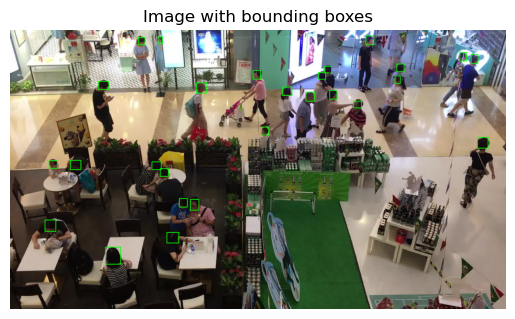

Reading one random image and JSON from folder: dataset\train\11


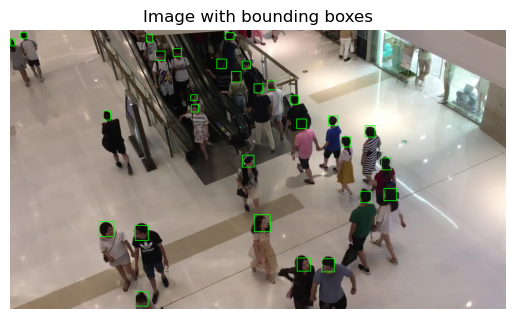

Reading one random image and JSON from folder: dataset\train\12


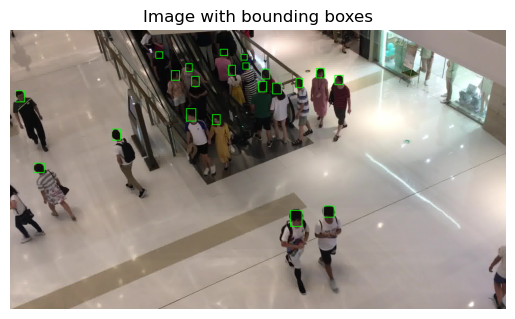

Reading one random image and JSON from folder: dataset\train\13


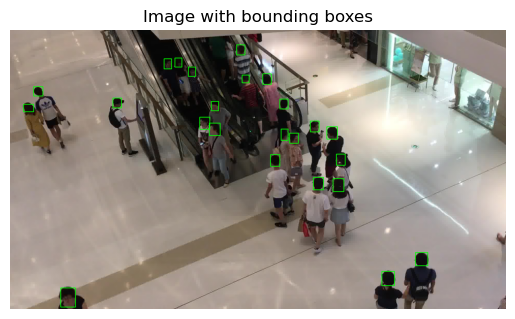

Reading one random image and JSON from folder: dataset\train\16


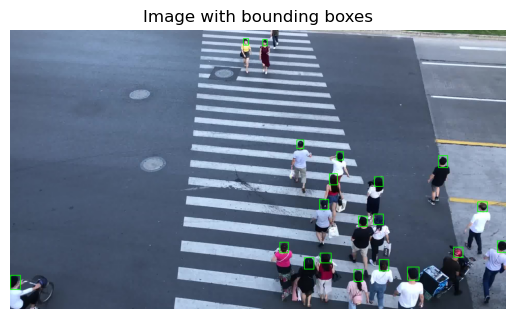

Reading one random image and JSON from folder: dataset\train\17


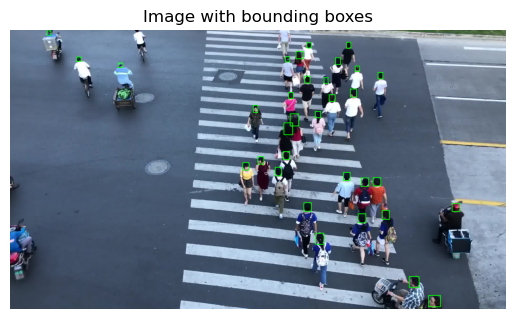

Reading one random image and JSON from folder: dataset\train\18


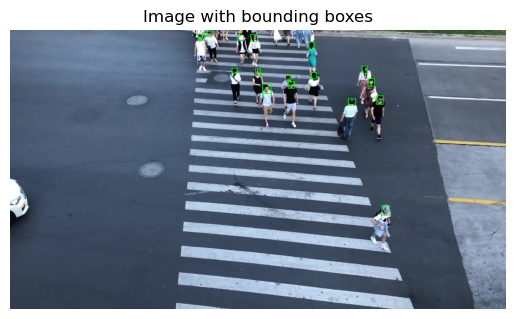

Reading one random image and JSON from folder: dataset\train\2


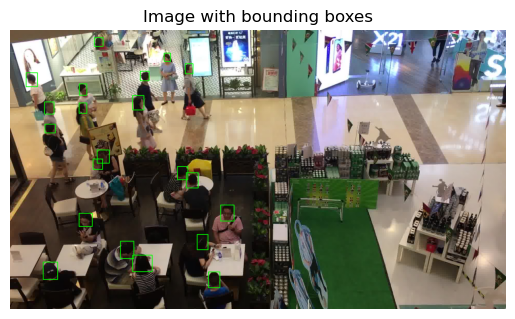

Reading one random image and JSON from folder: dataset\train\21


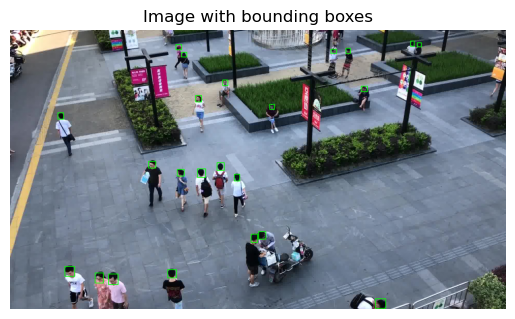

Reading one random image and JSON from folder: dataset\train\22


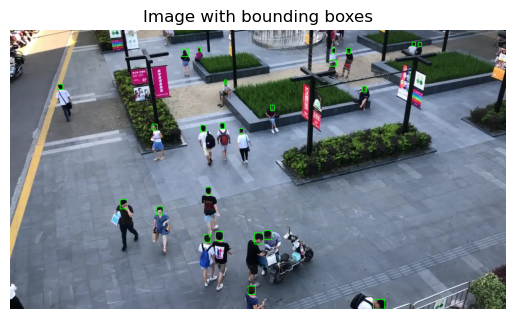

Reading one random image and JSON from folder: dataset\train\23


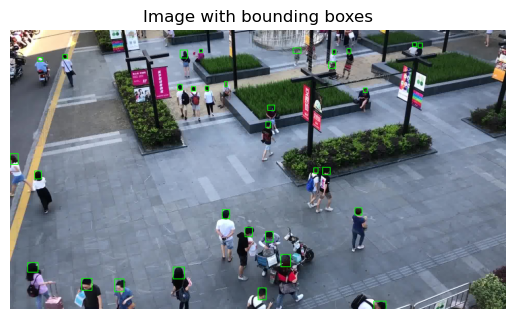

Reading one random image and JSON from folder: dataset\train\26


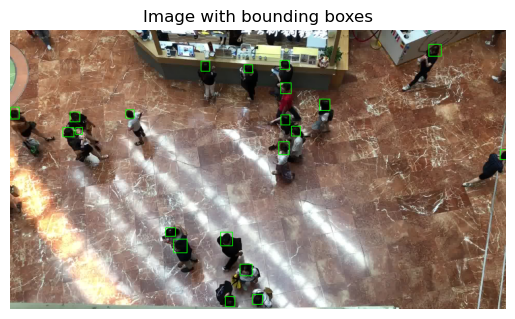

Reading one random image and JSON from folder: dataset\train\27


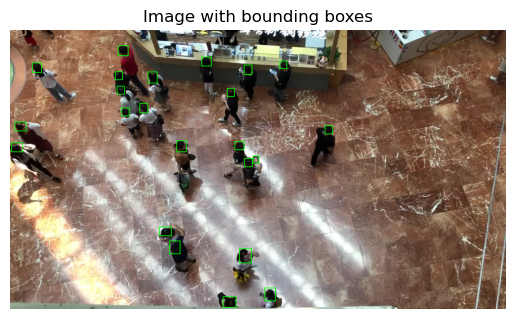

Reading one random image and JSON from folder: dataset\train\28


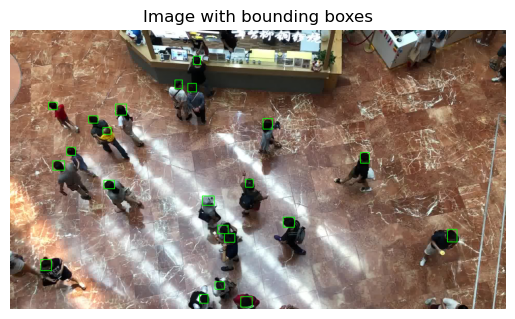

Reading one random image and JSON from folder: dataset\train\3


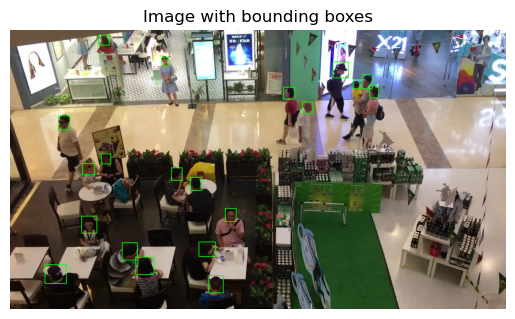

Reading one random image and JSON from folder: dataset\train\31


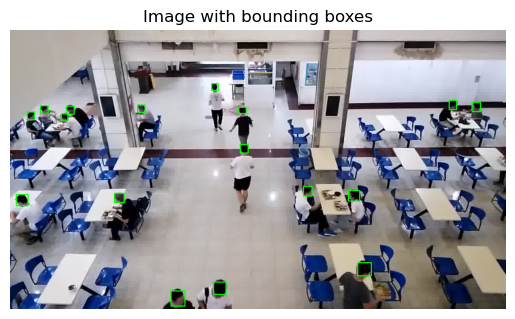

Reading one random image and JSON from folder: dataset\train\32


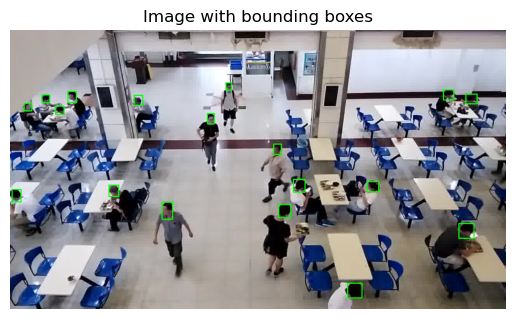

Reading one random image and JSON from folder: dataset\train\33


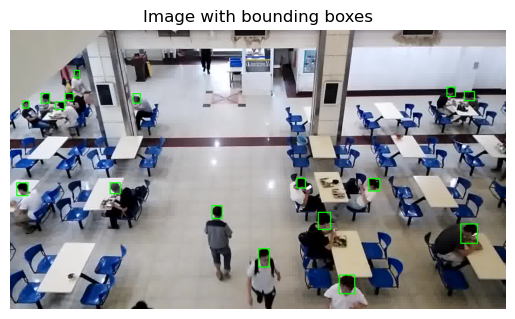

Reading one random image and JSON from folder: dataset\train\36


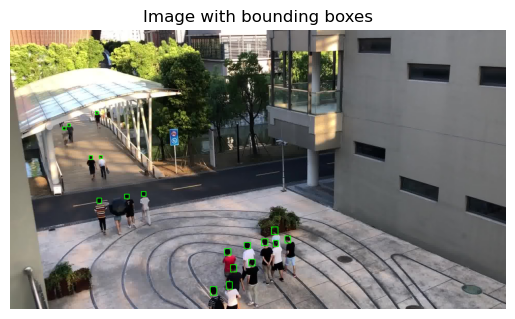

Reading one random image and JSON from folder: dataset\train\37


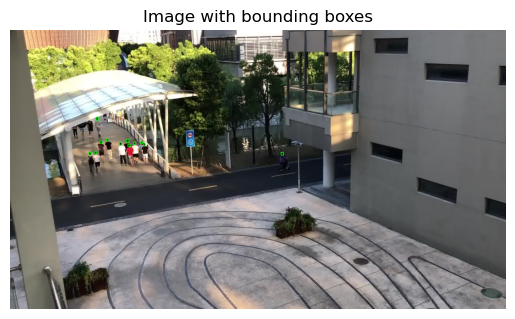

Reading one random image and JSON from folder: dataset\train\38


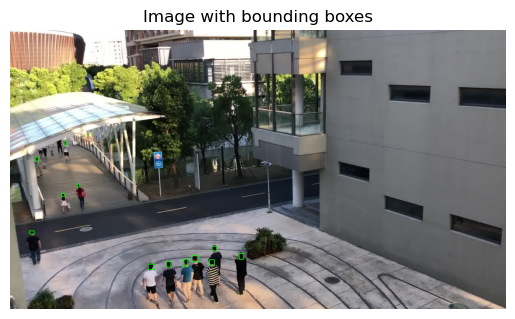

Reading one random image and JSON from folder: dataset\train\41


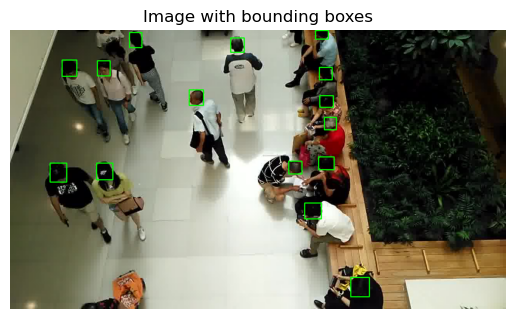

Reading one random image and JSON from folder: dataset\train\42


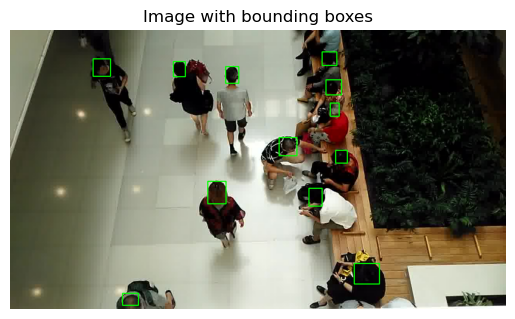

Reading one random image and JSON from folder: dataset\train\43


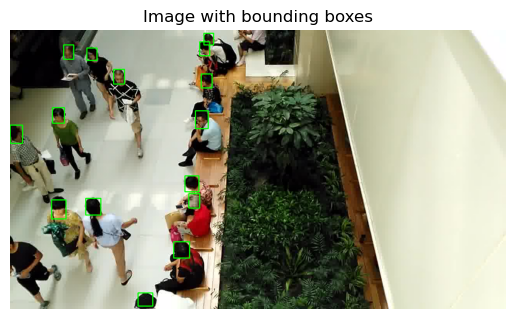

Reading one random image and JSON from folder: dataset\train\46


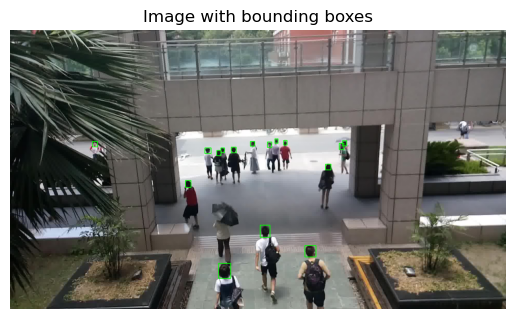

Reading one random image and JSON from folder: dataset\train\47


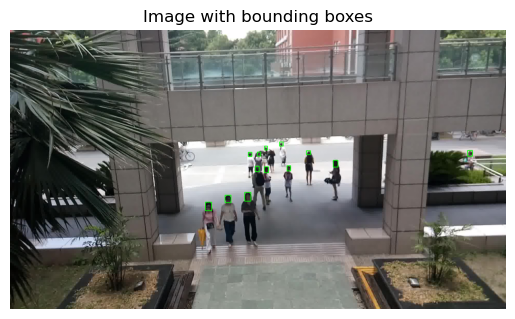

Reading one random image and JSON from folder: dataset\train\48


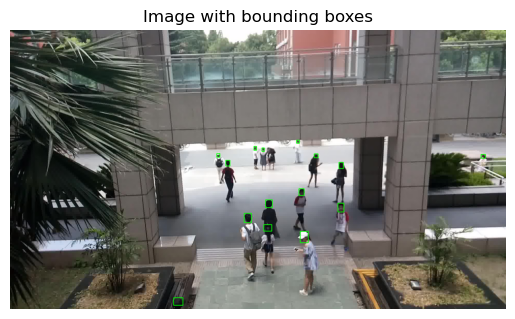

Reading one random image and JSON from folder: dataset\train\51


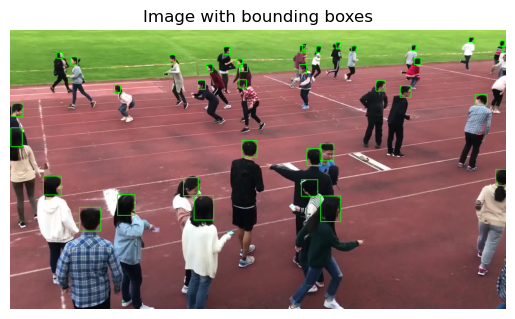

Reading one random image and JSON from folder: dataset\train\52


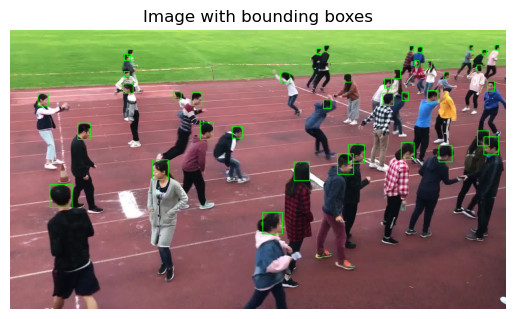

Reading one random image and JSON from folder: dataset\train\53


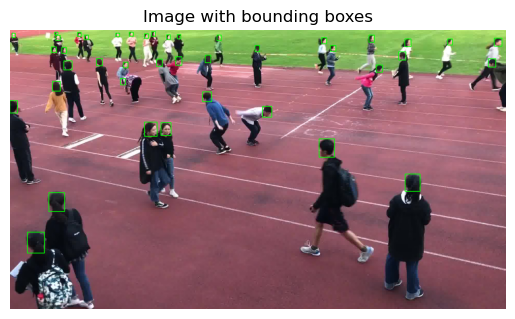

Reading one random image and JSON from folder: dataset\train\56


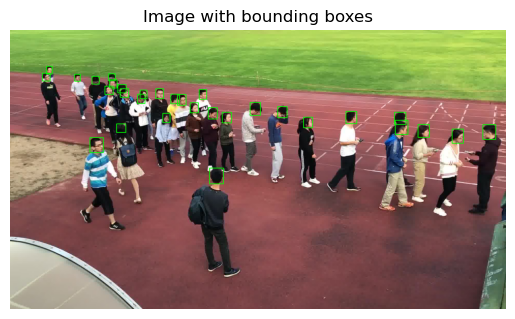

Reading one random image and JSON from folder: dataset\train\57


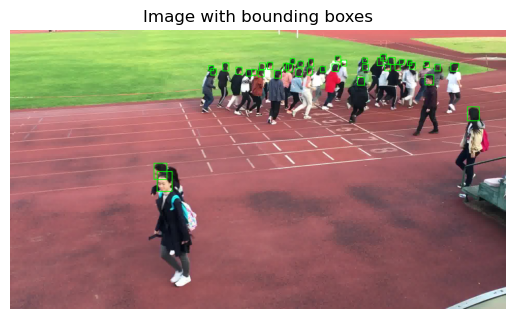

Reading one random image and JSON from folder: dataset\train\58


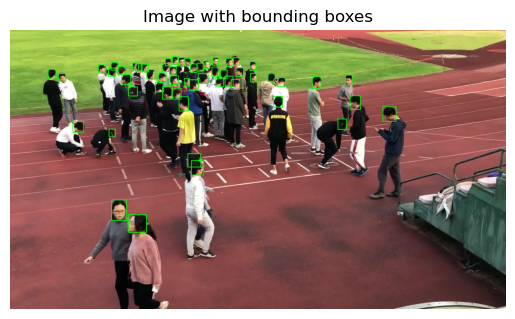

Reading one random image and JSON from folder: dataset\train\6


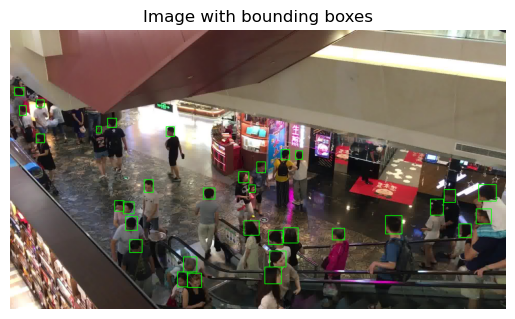

Reading one random image and JSON from folder: dataset\train\61


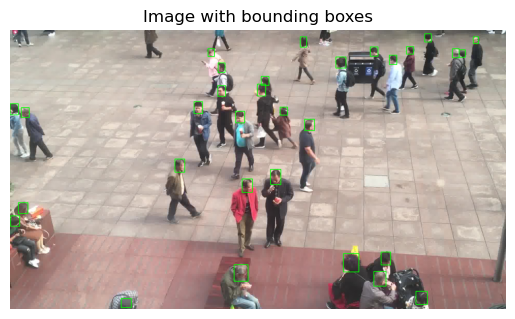

Reading one random image and JSON from folder: dataset\train\62


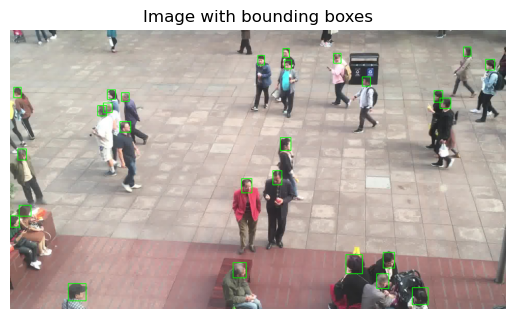

Reading one random image and JSON from folder: dataset\train\63


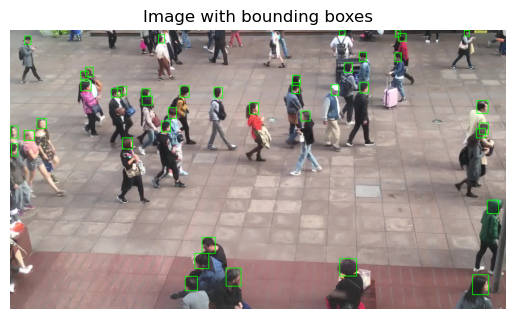

Reading one random image and JSON from folder: dataset\train\66


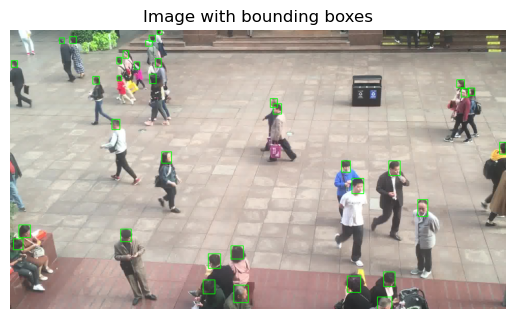

Reading one random image and JSON from folder: dataset\train\67


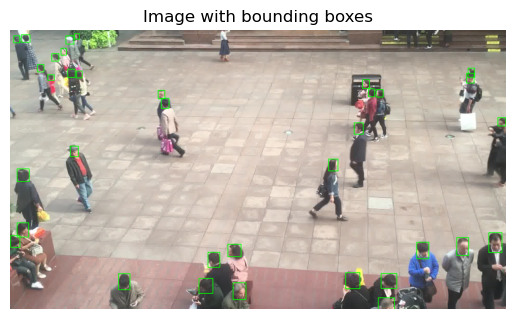

Reading one random image and JSON from folder: dataset\train\68


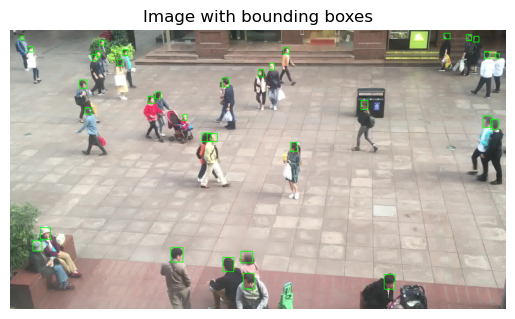

Reading one random image and JSON from folder: dataset\train\7


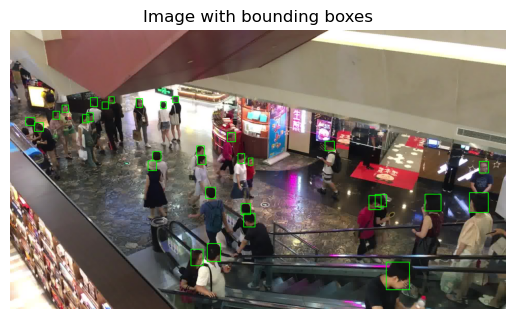

Reading one random image and JSON from folder: dataset\train\71


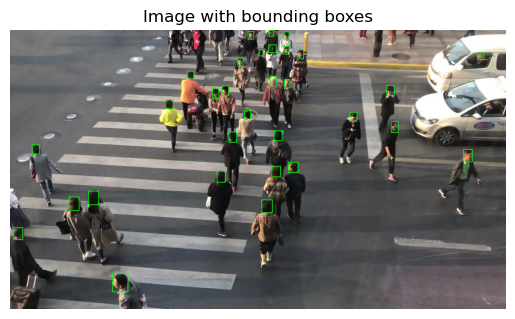

Reading one random image and JSON from folder: dataset\train\72


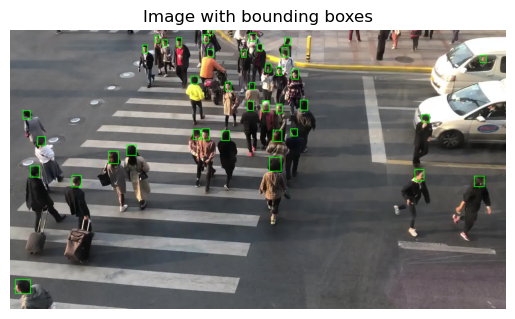

Reading one random image and JSON from folder: dataset\train\73


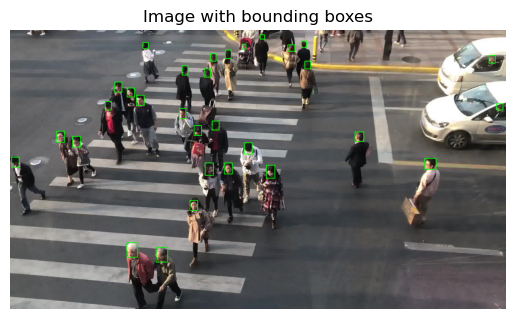

Reading one random image and JSON from folder: dataset\train\76


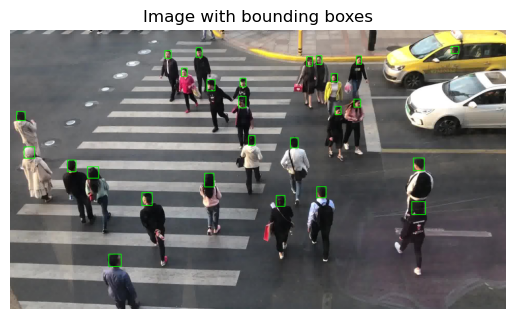

Reading one random image and JSON from folder: dataset\train\77


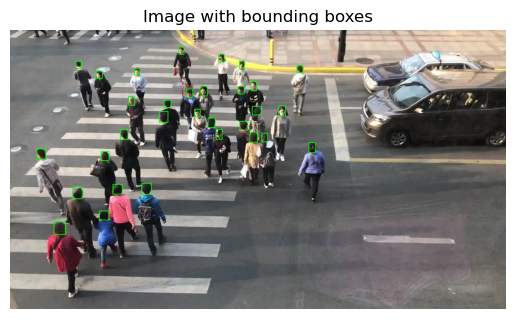

Reading one random image and JSON from folder: dataset\train\78


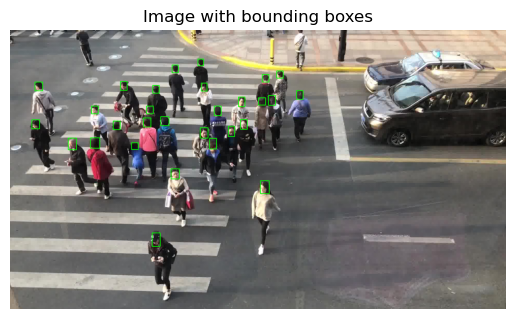

Reading one random image and JSON from folder: dataset\train\8


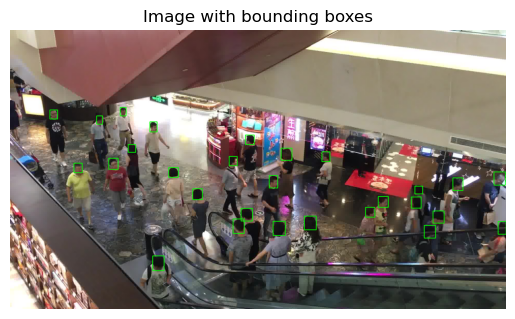

Reading one random image and JSON from folder: dataset\train\81


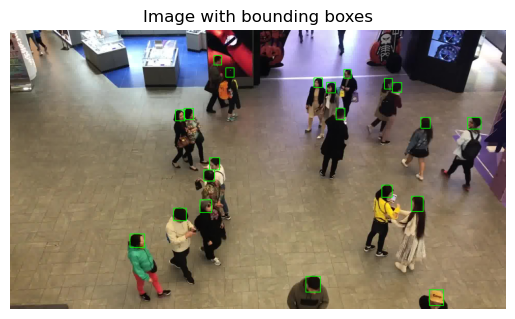

Reading one random image and JSON from folder: dataset\train\82


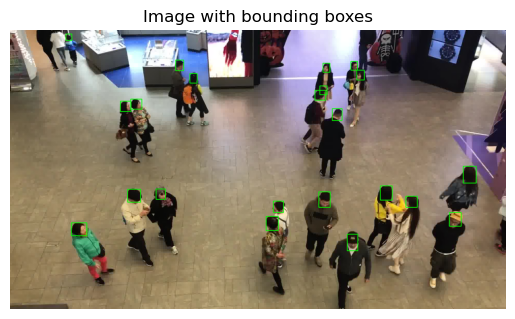

Reading one random image and JSON from folder: dataset\train\83


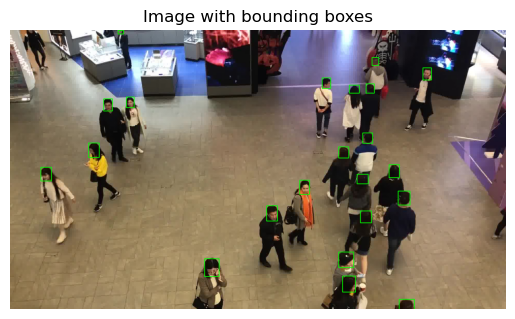

Reading one random image and JSON from folder: dataset\train\86


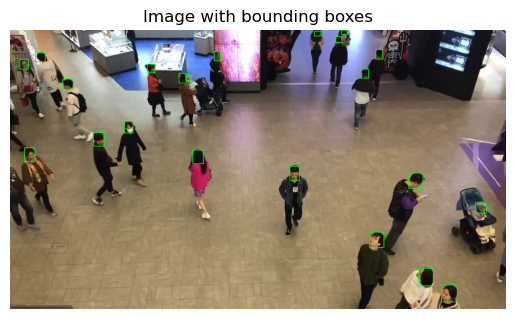

Reading one random image and JSON from folder: dataset\train\87


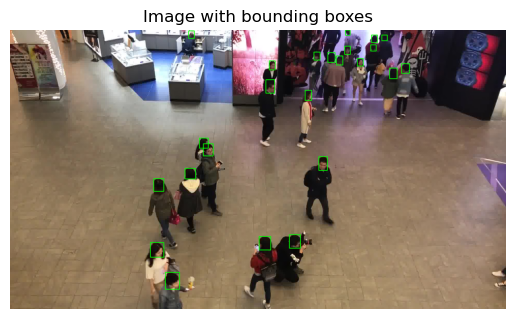

Reading one random image and JSON from folder: dataset\train\88


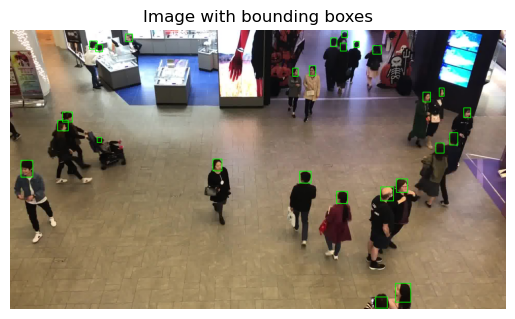

Reading one random image and JSON from folder: dataset\train\91


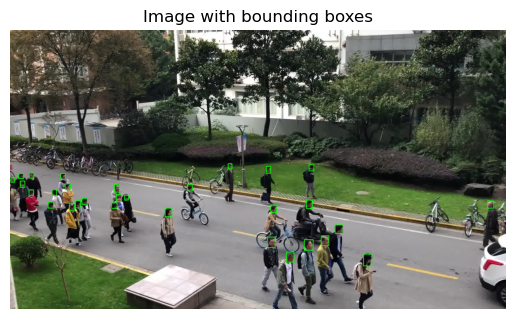

Reading one random image and JSON from folder: dataset\train\92


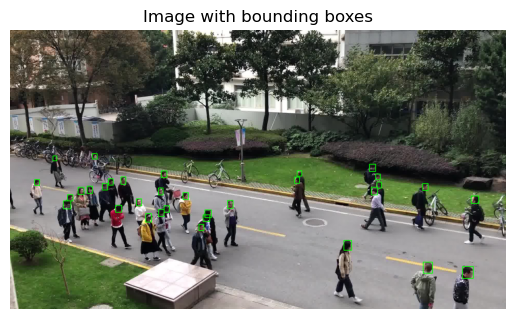

Reading one random image and JSON from folder: dataset\train\93


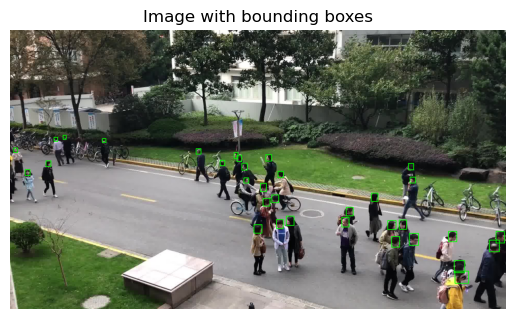

Reading one random image and JSON from folder: dataset\train\96


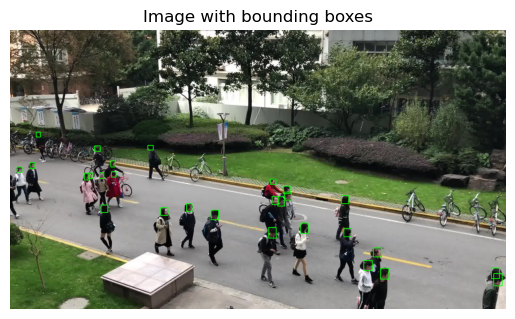

Reading one random image and JSON from folder: dataset\train\97


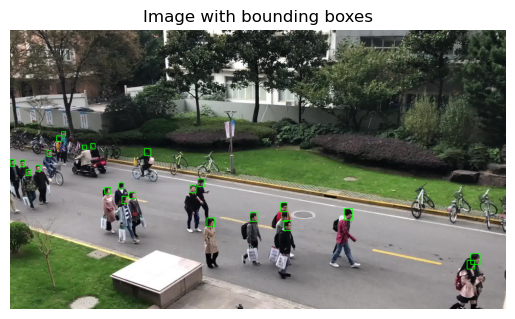

Reading one random image and JSON from folder: dataset\train\98


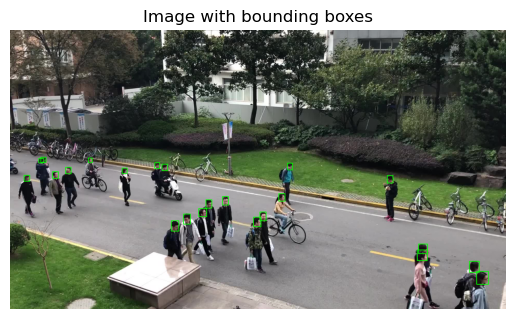

Reading one random image and JSON from folder: dataset\test\10


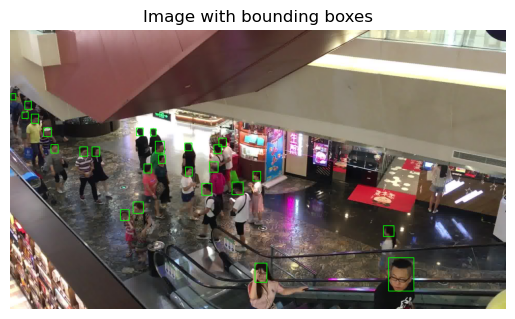

Reading one random image and JSON from folder: dataset\test\100


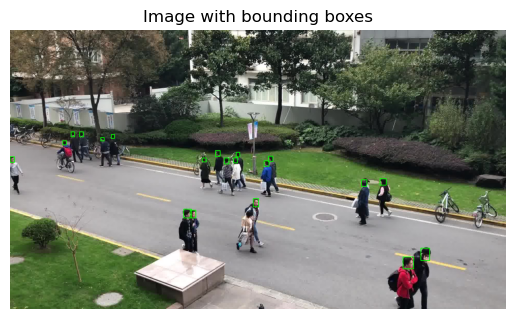

Reading one random image and JSON from folder: dataset\test\14


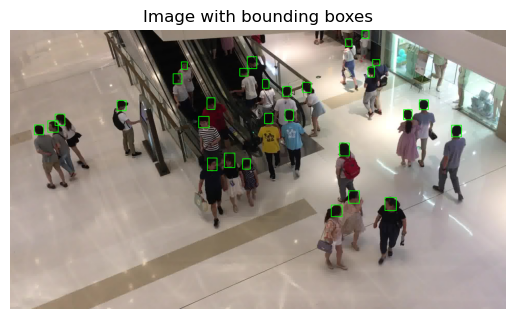

Reading one random image and JSON from folder: dataset\test\15


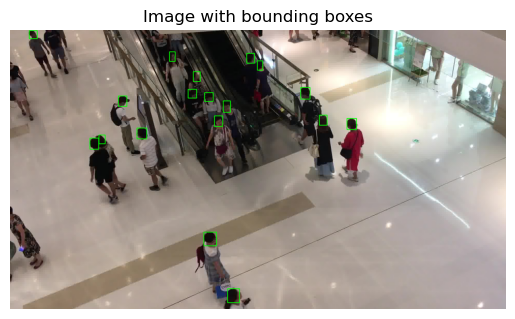

Reading one random image and JSON from folder: dataset\test\19


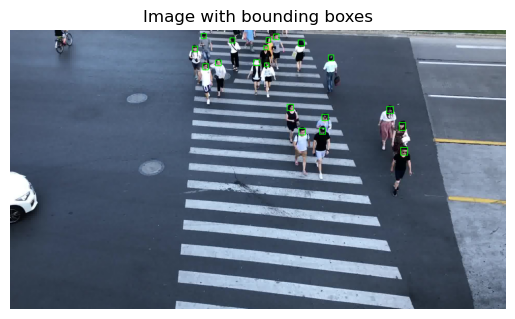

Reading one random image and JSON from folder: dataset\test\20


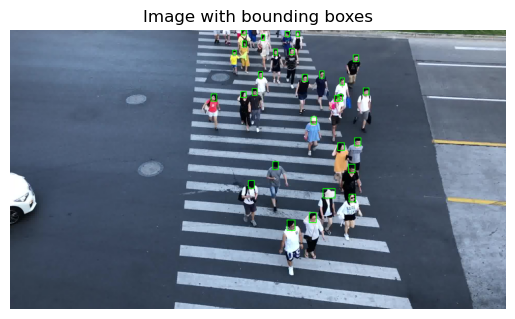

Reading one random image and JSON from folder: dataset\test\24


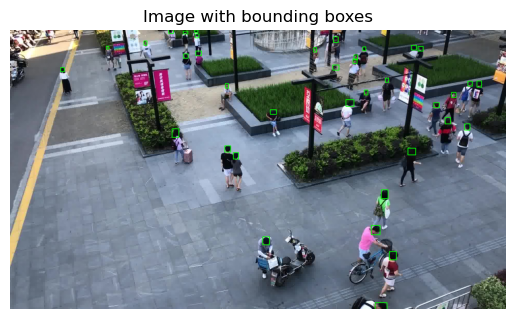

Reading one random image and JSON from folder: dataset\test\25


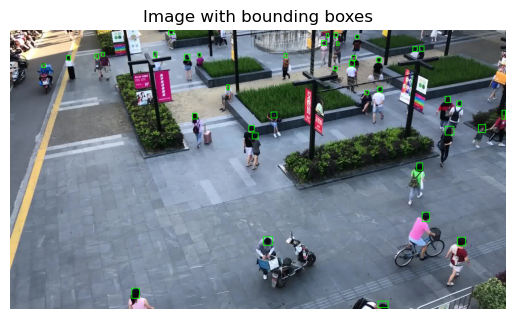

Reading one random image and JSON from folder: dataset\test\29


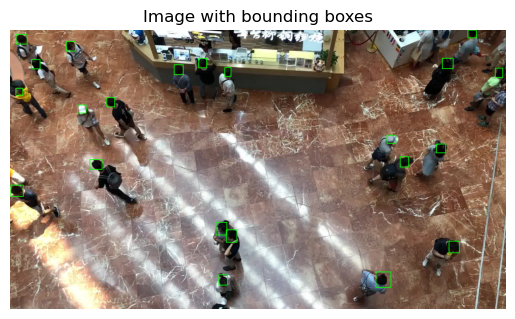

Reading one random image and JSON from folder: dataset\test\30


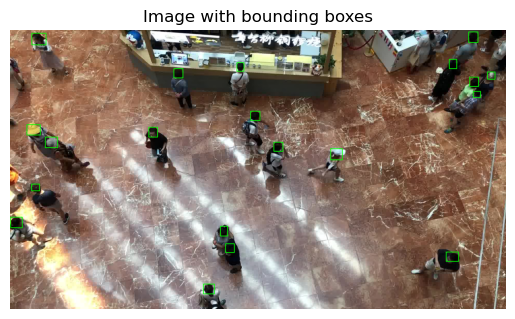

Reading one random image and JSON from folder: dataset\test\34


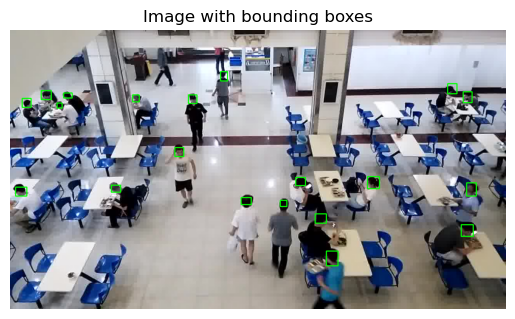

Reading one random image and JSON from folder: dataset\test\35


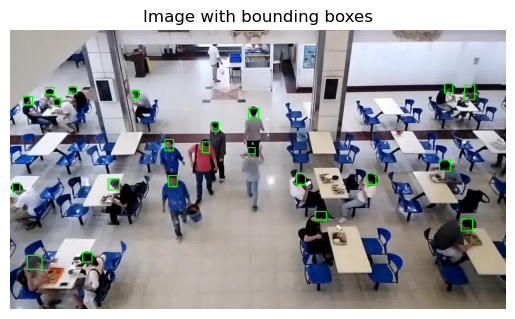

Reading one random image and JSON from folder: dataset\test\39


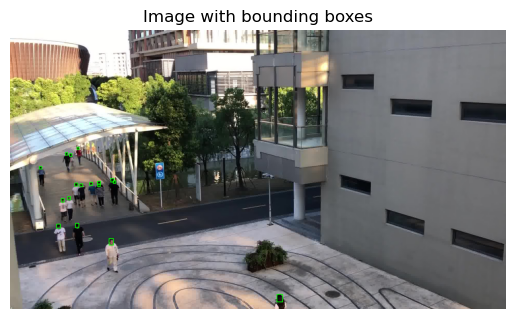

Reading one random image and JSON from folder: dataset\test\4


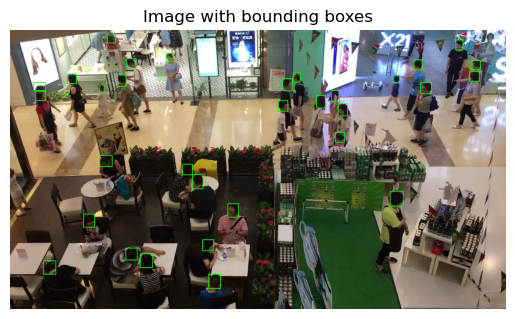

Reading one random image and JSON from folder: dataset\test\40


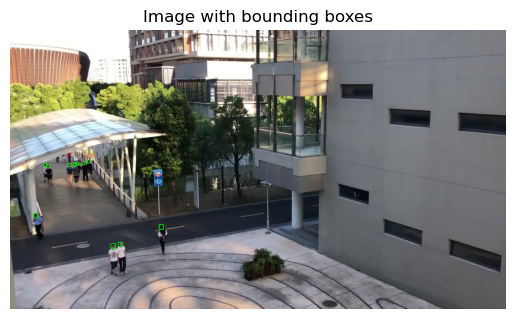

Reading one random image and JSON from folder: dataset\test\44


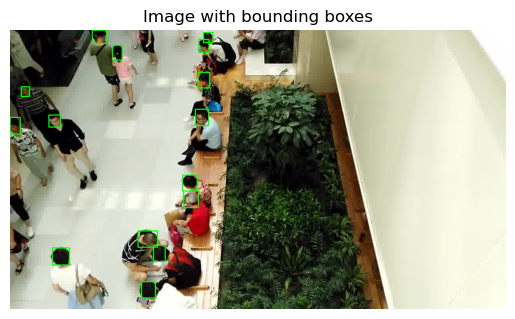

Reading one random image and JSON from folder: dataset\test\45


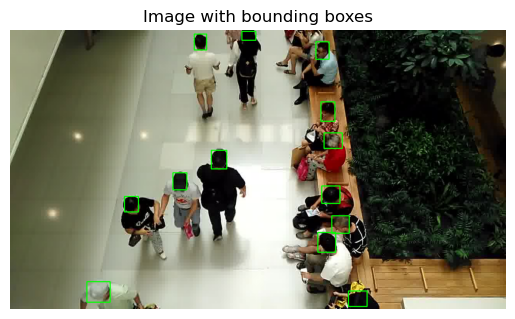

Reading one random image and JSON from folder: dataset\test\49


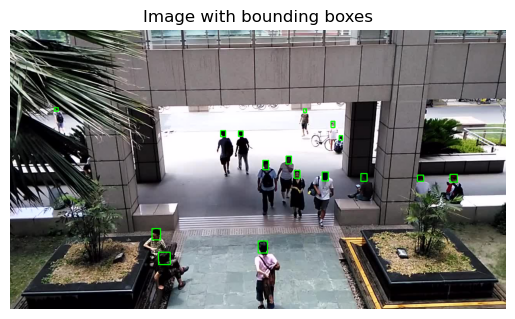

Reading one random image and JSON from folder: dataset\test\5


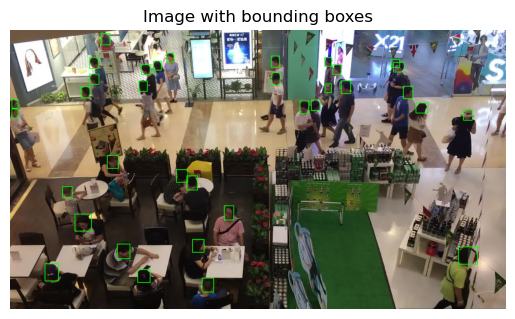

Reading one random image and JSON from folder: dataset\test\50


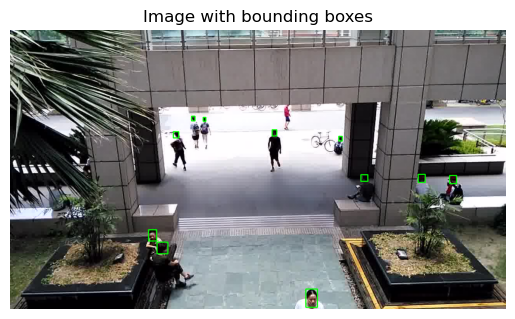

Reading one random image and JSON from folder: dataset\test\54


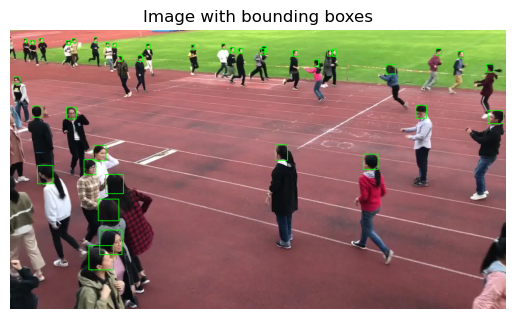

Reading one random image and JSON from folder: dataset\test\55


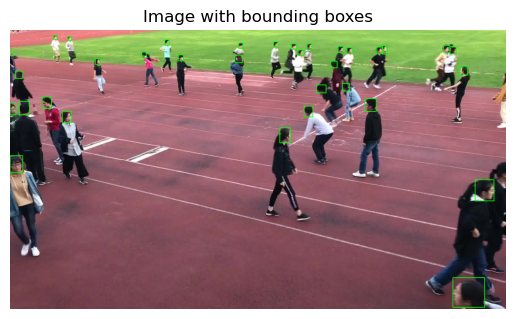

Reading one random image and JSON from folder: dataset\test\59


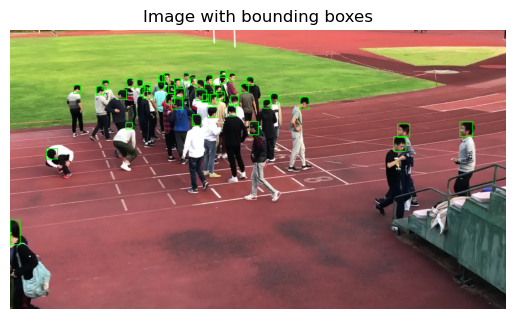

Reading one random image and JSON from folder: dataset\test\60


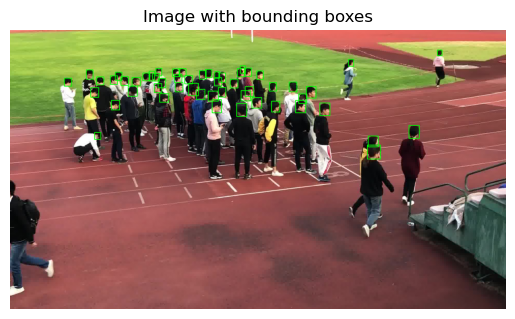

Reading one random image and JSON from folder: dataset\test\64


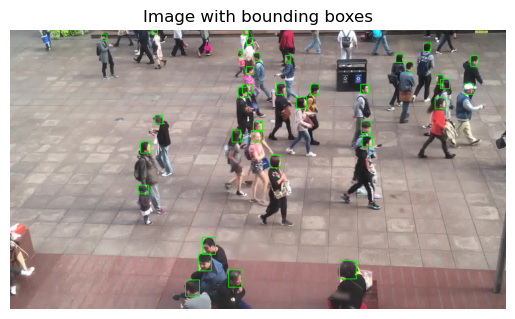

Reading one random image and JSON from folder: dataset\test\65


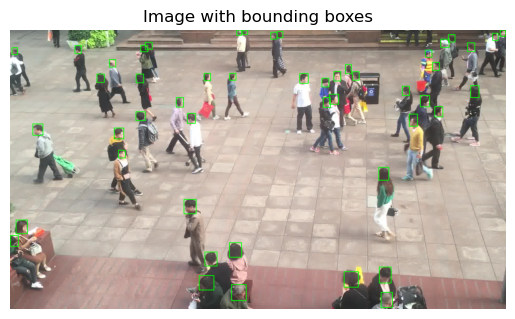

Reading one random image and JSON from folder: dataset\test\69


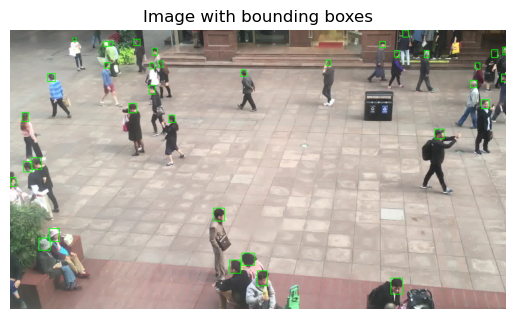

Reading one random image and JSON from folder: dataset\test\70


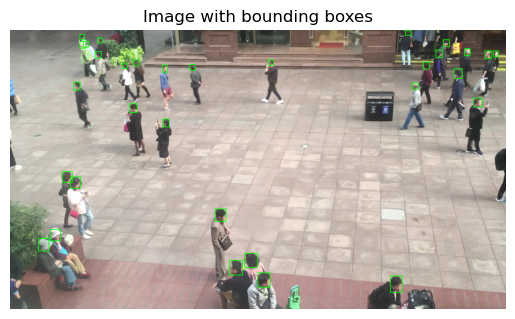

Reading one random image and JSON from folder: dataset\test\74


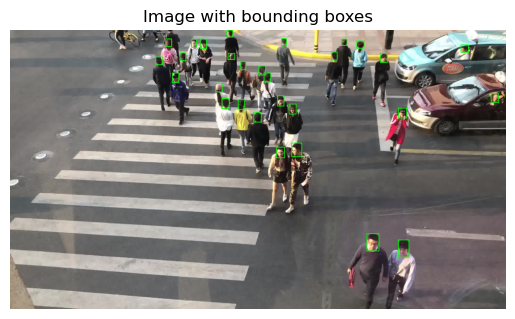

Reading one random image and JSON from folder: dataset\test\75


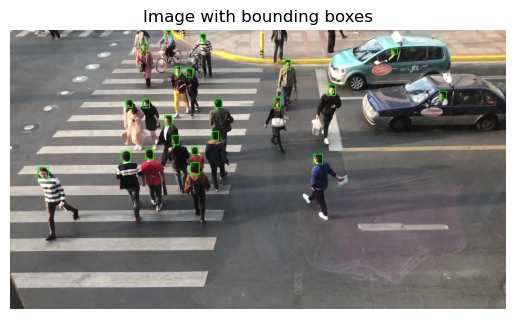

Reading one random image and JSON from folder: dataset\test\79


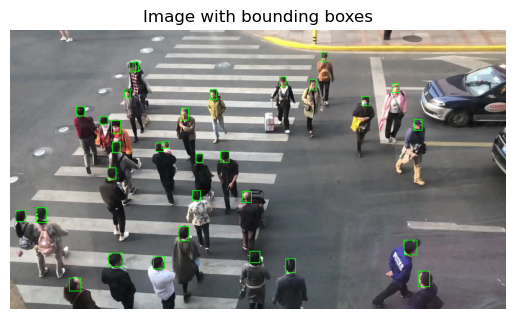

Reading one random image and JSON from folder: dataset\test\80


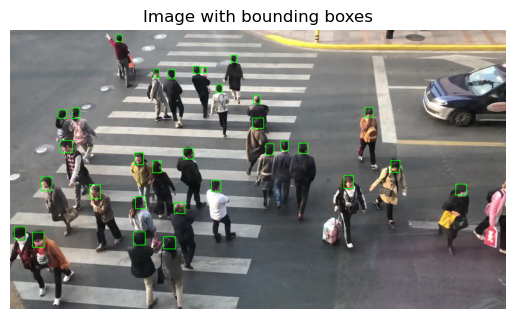

Reading one random image and JSON from folder: dataset\test\84


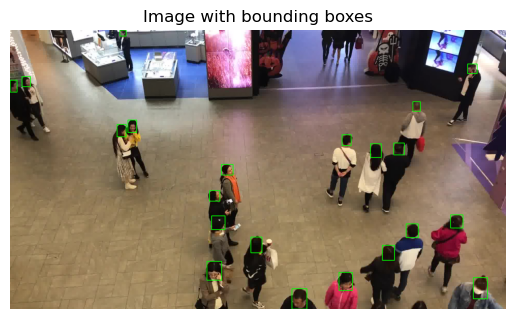

Reading one random image and JSON from folder: dataset\test\85


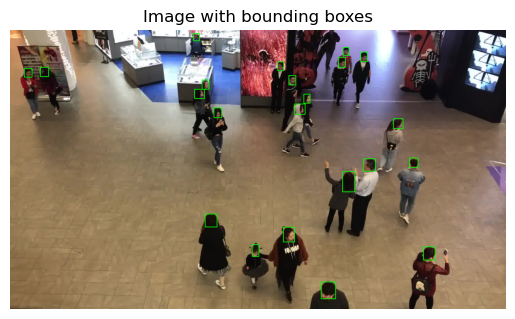

Reading one random image and JSON from folder: dataset\test\89


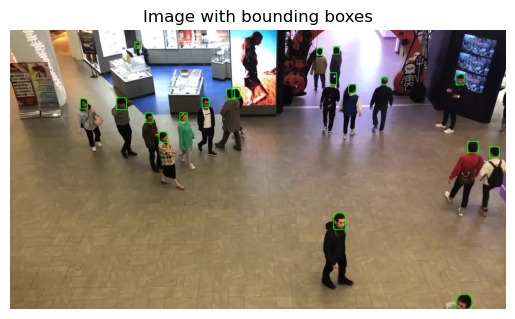

Reading one random image and JSON from folder: dataset\test\9


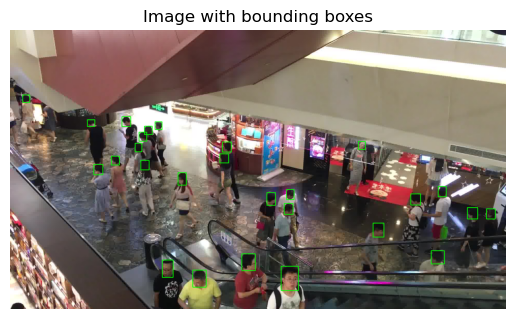

Reading one random image and JSON from folder: dataset\test\90


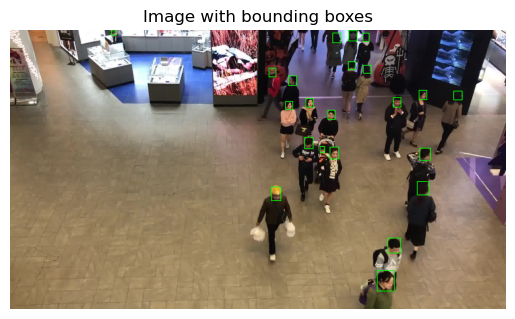

Reading one random image and JSON from folder: dataset\test\94


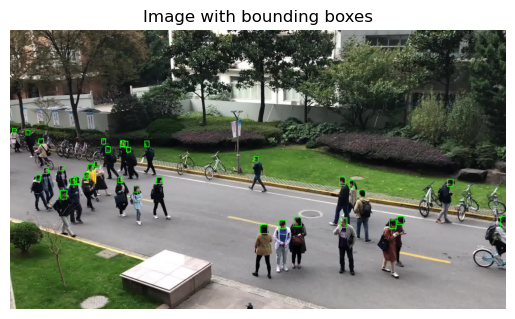

Reading one random image and JSON from folder: dataset\test\95


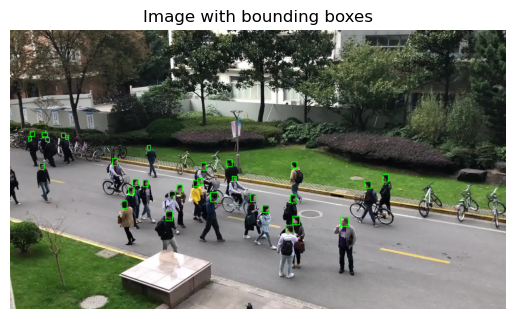

Reading one random image and JSON from folder: dataset\test\99


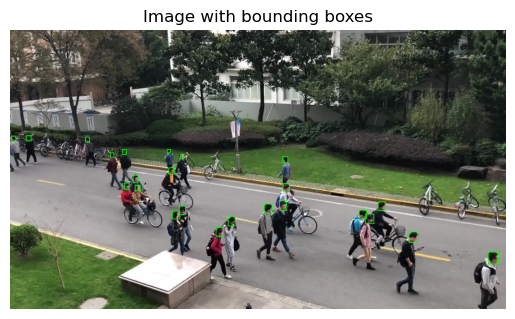

In [20]:
if __name__ == "__main__":
    root_directory = 'dataset'
    main(root_directory)
